**непараметрическая регрессия**

Евгений Борисов esborisov@sevsu.ru

# загружаем данные

In [1]:
from sklearn.datasets import fetch_california_housing

data = fetch_california_housing(as_frame=True)
display( data.keys() )

dict_keys(['data', 'target', 'frame', 'target_names', 'feature_names', 'DESCR'])

In [2]:
print( data['DESCR'] )

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

:Number of Instances: 20640

:Number of Attributes: 8 numeric, predictive attributes and the target

:Attribute Information:
    - MedInc        median income in block group
    - HouseAge      median house age in block group
    - AveRooms      average number of rooms per household
    - AveBedrms     average number of bedrooms per household
    - Population    block group population
    - AveOccup      average number of household members
    - Latitude      block group latitude
    - Longitude     block group longitude

:Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived from the 1990 U.S. census, using one row per ce

In [4]:
display( data['frame'].sample(3) )

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
12851,3.5429,29.0,6.148936,1.057283,2022.0,3.309329,38.68,-121.37,0.882
8462,3.3491,39.0,3.675676,0.936937,1106.0,3.321321,33.91,-118.33,1.818
13379,5.5198,14.0,6.559751,1.031120,7363.0,3.055187,34.14,-117.61,2.456


# обработка геометки

https://geopandas.org/en/stable/getting_started/introduction.html

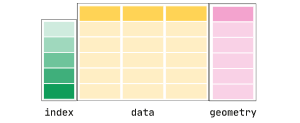

In [5]:
import geopandas as gpd
from shapely.geometry import MultiPoint

In [6]:
gdf = gpd.GeoDataFrame(
        data['frame'],
        geometry=gpd.points_from_xy( data['frame']['Longitude'], data['frame']['Latitude'] ), 
        crs='epsg:4326'
    )

display( len(gdf) )
display( gdf.sample(3) )

20640

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,geometry
17480,2.1471,26.0,4.529248,1.044568,1580.0,4.401114,34.38,-119.86,1.875,POINT (-119.86000 34.38000)
14498,5.2326,16.0,5.045181,1.066265,604.0,1.819277,32.86,-117.23,1.883,POINT (-117.23000 32.86000)
9339,7.7006,52.0,6.607143,1.107143,150.0,2.678571,37.97,-122.62,3.167,POINT (-122.62000 37.97000)


In [7]:
del data


----

In [8]:
# загружем геоданные по административным границам 

# https://data.ca.gov/dataset/ca-geographic-boundaries -> CA Places Boundaries

gdf_calif = gpd.read_file('data/ca-places-boundaries/CA_Places_TIGER2016.dbf')
display(len(gdf_calif))
display(gdf_calif.sample(3))

1522

,STATEFP,PLACEFP,PLACENS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,PCICBSA,PCINECTA,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
1350,06,72408,02583146,0672408,Snelling,Snelling CDP,57,U1,N,N,G4210,S,1399517,0,+37.5216621,-120.4384990,"POLYGON ((-13408228.048 4511368.752, -13408220..."
1115,06,49045,02583086,0649045,Monument Hills,Monument Hills CDP,57,U1,N,N,G4210,S,10432735,0,+38.6641407,-121.8755847,"POLYGON ((-13569312.734 4672589.478, -13569311..."
540,06,04734,02407815,0604734,Bear Valley Springs,Bear Valley Springs CDP,57,U1,N,N,G4210,S,107445360,169947,+35.1793999,-118.6259708,"POLYGON ((-13218907.044 4190737.020, -13218714..."


---

In [9]:
# добавляем геоданные административных границ к геометкам объектов

display(len(gdf))

gdf_ = gdf_calif[['NAME','geometry']].sjoin(
        gdf.to_crs(gdf_calif.crs), 
        how='inner'
    ).rename(columns={'index_right':'point_idx','NAME':'district_name'})

display(len(gdf_))
display(gdf_.sample(3))

20640

18003

,district_name,geometry,point_idx,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
99,Riverside,"POLYGON ((-13082697.482 4021905.285, -13082697...",11908,3.8618,41.0,6.345725,1.026022,660.0,2.453532,33.97,-117.40,1.348
44,Los Angeles,"POLYGON ((-13210082.292 4054325.759, -13210078...",4451,1.8781,29.0,3.751269,1.048223,1580.0,4.010152,34.06,-118.21,1.475
44,Los Angeles,"POLYGON ((-13210082.292 4054325.759, -13210078...",5639,5.6611,42.0,5.932515,1.073620,481.0,2.950920,33.75,-118.30,2.656


In [10]:
# медиана цены по районам

gdf_ = gpd.GeoDataFrame(
        gdf_[['district_name','MedHouseVal','geometry']]
        .groupby(['district_name','geometry'])
        ['MedHouseVal'].median()
        .reset_index()
    )
display(len(gdf_))
display(gdf_.sample(3))

986

,district_name,geometry,MedHouseVal
617,Oak Hills,"MULTIPOLYGON (((-13072630.862 4075427.849, -13...",1.2970
420,Kernville,"POLYGON ((-13187578.623 4268581.089, -13187568...",0.9600
425,Kingsburg,"POLYGON ((-13313384.037 4376155.013, -13313381...",0.7015


In [11]:
# рисуем интерактивную карту
gdf_.explore(
        column='MedHouseVal', 
        cmap='coolwarm', 
        legend=True,
        figsize=(11,11)
    )

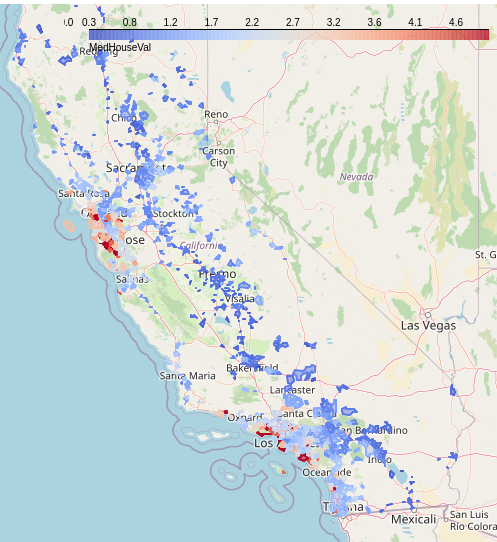

----

# строим модель регрессии

In [12]:
from sklearn.neighbors import KNeighborsRegressor

In [13]:
# будем предсказывать цену по вектору свойств объекта и геометке

col_features = ['MedInc','HouseAge','AveRooms','AveBedrms','Population','AveOccup','Latitude','Longitude']
X,target = gdf[col_features].values, gdf['MedHouseVal'].values

# разделяем датасет на учебные и тестовые данные
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X,target,test_size=.5)
display( ( X_train.shape, X_test.shape) )

del X, target

((10320, 8), (10320, 8))

In [14]:
# обучаем модель
model = KNeighborsRegressor().fit(X_train,y_train)

In [15]:
# оценка результатов

from sklearn.metrics import mean_squared_error

predicted = model.predict(X_test)
display( mean_squared_error(y_true=y_test, y_pred=predicted) )

1.2029164935578176

---

In [16]:
# запускаем поиск хороших сочетаний гиперпараметров модели
param_grid = { # списки значений гиперпараметров модели, которые будем тестировать
     'metric': ['euclidean','manhattan','chebyshev','minkowski','hamming','canberra','braycurtis',],
'n_neighbors': [1,5,9,16,32,128],
}

## полный перебор всех сочетаний гиперпараметров
# from sklearn.model_selection import GridSearchCV
#
# grid = GridSearchCV(
#         estimator=KNeighborsRegressor(),
#         param_grid=param_grid,
#         scoring='neg_mean_squared_error',
#     ).fit(X_train,y_train)


# ограниченный перебор случайных сочетаний гиперпараметров
from sklearn.model_selection import RandomizedSearchCV

grid = RandomizedSearchCV(
        estimator=KNeighborsRegressor(), 
        param_distributions=param_grid,
        scoring='neg_mean_squared_error',
        n_iter=5,
    ).fit(X_train,y_train)


display( grid.best_score_ )
display( grid.best_params_ )

model_ = grid.best_estimator_

-1.0880104433251192

{'n_neighbors': 5, 'metric': 'manhattan'}

In [17]:
# оценка результатов

predicted = model_.predict(X_test)
display( mean_squared_error(y_true=y_test, y_pred=predicted) )

1.0707868458481091

----

In [18]:
# !pip3 install watermark

In [20]:
%load_ext watermark
%watermark --python
%watermark --iversions

Python implementation: CPython
Python version       : 3.11.8
IPython version      : 8.21.0

geopandas: 0.14.3

